
# Imports and Setup of Data

In [2]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt
%config InlineBackend.figure_format = "svg"

In [ ]:
# Load our data from our github
#Use last 5 seasons of basketball statistics
#Note: This spreadsheet was created by us from multiple different sources
df1 = pd.read_excel("https://github.com/afick/NBAStatsAnalysis/blob/main/fullStats.xlsx?raw=true")

# Filter out empty columns
df1 = df1.loc[:, ~df1.columns.str.contains('^Unnamed')]

# Convert values to float
df1.iloc[:,2:-2] = df1.iloc[:,2:-2].astype(float)
df1['MOV'] = df1['MOV'].astype(float)

# Convert values to ints
df1['G'] = df1['G'].astype(int)
df1['Year'] = df1['Year'].astype(int)
df1['Wins'] = df1['Wins'].astype(int)

df1

,Team,G,MP,FG,FGA,FG%,3P,3PA,3P%,2P,...,STL,BLK,TOV,PF,PTS,Year,TS%,Wins,Playoffs,MOV
0,Atlanta Hawks*,82,19705.0,3401.0,7241.0,0.470,1056.0,2821.0,0.374,2345.0,...,587.0,348.0,972.0,1534.0,9343.0,2021,0.581,43,Success,1.56
1,Boston Celtics*,82,19905.0,3341.0,7167.0,0.466,1085.0,3044.0,0.356,2256.0,...,591.0,478.0,1118.0,1521.0,9164.0,2021,0.578,51,Finals,7.28
2,Brooklyn Nets*,82,19755.0,3442.0,7251.0,0.475,940.0,2602.0,0.361,2502.0,...,582.0,448.0,1153.0,1670.0,9258.0,2021,0.576,44,Success,0.78
3,Charlotte Hornets,82,19880.0,3508.0,7497.0,0.468,1143.0,3130.0,0.365,2365.0,...,707.0,402.0,1087.0,1629.0,9457.0,2021,0.572,46,Failure,0.44
4,Chicago Bulls*,82,19730.0,3422.0,7127.0,0.480,872.0,2364.0,0.369,2550.0,...,585.0,336.0,1053.0,1540.0,9152.0,2021,0.579,43,Success,-0.39
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,Sacramento Kings,82,19755.0,3179.0,7063.0,0.450,738.0,1967.0,0.375,2441.0,...,643.0,340.0,1125.0,1639.0,8104.0,2017,0.529,27,Failure,-6.99
146,San Antonio Spurs*,82,19730.0,3202.0,6999.0,0.457,696.0,1977.0,0.352,2506.0,...,628.0,460.0,1078.0,1408.0,8424.0,2017,0.543,47,Success,2.89
147,Toronto Raptors*,82,19830.0,3383.0,7169.0,0.472,968.0,2705.0,0.358,2415.0,...,626.0,500.0,1095.0,1783.0,9156.0,2017,0.575,59,Success,7.78
148,Utah Jazz*,82,19755.0,3139.0,6797.0,0.462,887.0,2425.0,0.366,2252.0,...,708.0,420.0,1205.0,1608.0,8540.0,2017,0.564,48,Success,4.30


In [ ]:
# Check out all the columns
df1.columns

Index(['Team', 'G', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P', '2PA',
       '2P%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK',
       'TOV', 'PF', 'PTS', 'Year', 'TS%', 'Wins', 'Playoffs', 'MOV'],
      dtype='object')

# Building New Features

In [ ]:
# Select features relevant to our data analysis
df_filtered = df1[['Team', 'FG%', 'TS%', '3P%', '3PA', 'FGA', 'AST', 'BLK', 'TOV', 'Wins', 'G', 'Playoffs', 'MOV', 'PTS', 'Year', 'FT%', '2P%', 'TRB']]

# Create other useful predictors
df_filtered['%3s'] = df_filtered['3PA']/df_filtered['FGA'] # The % of a team's shots that are 3s
df_filtered['BLKpG'] = df_filtered['BLK']/df_filtered['G']
df_filtered['Win%'] = df_filtered['Wins']/df_filtered['G']
df_filtered['TOVpG'] = df_filtered['TOV']/df_filtered['G']
df_filtered['PTSpG'] = df_filtered['PTS']/df_filtered['G']
df_filtered['ASTpG'] = df_filtered['AST']/df_filtered['G']

In [ ]:
# Check out some different winning percentages from the past 5 seasons (the extremes)
df_filtered['Win%'].sort_values()

In [ ]:
# The specific seasons of basketball that we are analyzing
df_filtered['Year'].unique()

array([2021, 2020, 2019, 2018, 2017])



```
# This is formatted as code
```

# Volume Metric Stats

In [ ]:
#Linear regression with only counting stats
data = df_filtered[["ASTpG", "BLKpG", 'PTSpG']]
x = data.to_numpy() # convert to numpy array
X = sm.add_constant(x) # add a column of all 1s
y = df_filtered[["Win%"]].to_numpy()
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

#Graph residuals
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Win% prediction")
ax.set_ylabel("Residual")

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.300
Model:                            OLS   Adj. R-squared:                  0.286
Method:                 Least Squares   F-statistic:                     20.85
Date:                Mon, 21 Nov 2022   Prob (F-statistic):           2.67e-11
Time:                        02:22:52   Log-Likelihood:                 104.87
No. Observations:                 150   AIC:                            -201.7
Df Residuals:                     146   BIC:                            -189.7
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -1.4538      0.254     -5.731      0.0

Text(0, 0.5, 'Residual')

In [ ]:
# Determine what is more significant (BLKpG vs PTSpG)
const, t, b, p = results.params

signf_b = b * np.std(data.BLKpG)
signf_p = p * np.std(data.PTSpG)

print(f'Significance of BLKSpG: {signf_b}\nSignificance of PTSpG: {signf_p}')

Significance of BLKSpG: 0.014563498028598796
Significance of PTSpG: 0.07292497706375321


# Efficiency Metric Model

In [ ]:
#Linear regression with 3 features (all the different shooting percentage statistics)
data = df_filtered[['FT%', '2P%','3P%']]
x = data.to_numpy() # convert to numpy array
X = sm.add_constant(x) # add a column of all 1s
y = df_filtered[["Win%"]].to_numpy()
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

#Graph residuals
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Win% prediction")
ax.set_ylabel("Residual")

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.522
Model:                            OLS   Adj. R-squared:                  0.512
Method:                 Least Squares   F-statistic:                     53.18
Date:                Sat, 19 Nov 2022   Prob (F-statistic):           2.73e-23
Time:                        03:34:55   Log-Likelihood:                 133.51
No. Observations:                 150   AIC:                            -259.0
Df Residuals:                     146   BIC:                            -247.0
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.8111      0.293     -9.602      0.0

Text(0, 0.5, 'Residual')

# Playmaker Model

In [ ]:
#Linear regression with 3 different features (low R^2 in this case)
data = df_filtered[['TOVpG','%3s', 'ASTpG']]
x = data.to_numpy() # convert to numpy array
X = sm.add_constant(x) # add a column of all 1s
y = df_filtered[["Win%"]].to_numpy()
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

#Graph residuals
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Win% prediction")
ax.set_ylabel("Residual")

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.198
Model:                            OLS   Adj. R-squared:                  0.182
Method:                 Least Squares   F-statistic:                     12.04
Date:                Sat, 19 Nov 2022   Prob (F-statistic):           4.37e-07
Time:                        20:06:55   Log-Likelihood:                 94.702
No. Observations:                 150   AIC:                            -181.4
Df Residuals:                     146   BIC:                            -169.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.3493      0.193      1.810      0.0

Text(0, 0.5, 'Residual')

# Categorical Variable Model

In [ ]:
#Linear regression with a categorical variable (have y be MOV)
data = df_filtered[['ASTpG','Playoffs']]
print(data['Playoffs'].unique()) #See below all the categorical values possible

data_x_new = pd.get_dummies(data,drop_first = True)
#default will be failure (meaning no playoffs), then first predictor is making it to the
#conference finals, and second is just making the playoffs (not all the way to the conference finals)

x = data_x_new.to_numpy() # convert to numpy array
X = sm.add_constant(x) # add a column of all 1s
y = df_filtered[["MOV"]].to_numpy()
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

#Graph residuals
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Plus Minus") #Plus-minus is other way to describe MOV (Points for - Points against)
ax.set_ylabel("Residual")

['Success' 'Finals' 'Failure']
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.649
Model:                            OLS   Adj. R-squared:                  0.642
Method:                 Least Squares   F-statistic:                     90.00
Date:                Sat, 19 Nov 2022   Prob (F-statistic):           5.00e-33
Time:                        21:44:17   Log-Likelihood:                -367.17
No. Observations:                 150   AIC:                             742.3
Df Residuals:                     146   BIC:                             754.4
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -16.7677

Text(0, 0.5, 'Residual')



# Autoregressive Model

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.276
Model:                            OLS   Adj. R-squared:                  0.270
Method:                 Least Squares   F-statistic:                     45.02
Date:                Mon, 21 Nov 2022   Prob (F-statistic):           7.14e-10
Time:                        02:35:24   Log-Likelihood:                 82.491
No. Observations:                 120   AIC:                            -161.0
Df Residuals:                     118   BIC:                            -155.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2402      0.040      5.984      0.0

Text(0, 0.5, 'Residual')

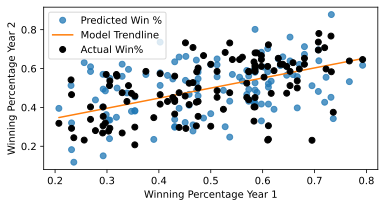

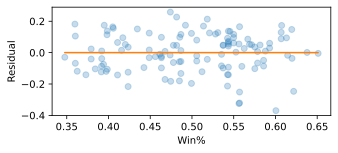

In [ ]:
# Autoregression of Wins year over year
data = df_filtered[['Year', 'Win%']]
minyear = min(data.Year)
maxyear = max(data.Year)

#Run linear regression
x = data[data.Year<maxyear]
x = x['Win%'].to_numpy()
y = data[data.Year>minyear]
y = y['Win%'].to_numpy()
X = sm.add_constant(x) # add a column of all 1s
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())
bhat, ahat = results.params #Grab values
sigma_eps_hat = np.sqrt(results.mse_resid)

# Graph it
# Graph generated points from the line of best fit that include error
fig,ax = plt.subplots(figsize=(6,3))
new_y = np.zeros(len(x))
for i in range(len(new_y)):
  new_y[i] = ahat*x[i] + bhat + np.random.normal(0, sigma_eps_hat)
ax.plot(x,new_y,"o", label="Predicted Win %", alpha = 0.75)
ax.plot(x,ahat*x + bhat, '-', label="Model Trendline") # graph line of best fit
ax.plot(x,y,"ko",  label="Actual Win%")
ax.set_xlabel("Winning Percentage Year 1")
ax.set_ylabel("Winning Percentage Year 2")
ax.legend()

#Graph residuals
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Win%")
ax.set_ylabel("Residual")

# Extra TS% Feature Model

In [ ]:
#Adding possible features (see if it increases R^2)
data = df_filtered[['TS%', 'Win%']]
data['TS%2'] = data['TS%']**2
data['TS%3'] = data['TS%']**3
data['TS%4'] = data['TS%']**4
data['TS%5'] = data['TS%']**5
data['TS%6'] = data['TS%']**6
data['TS%7'] = data['TS%']**7
data['TS%8'] = data['TS%']**8
data['TS%9'] = data['TS%']**9
data['TS%10'] = data['TS%']**10

y = data[['Win%']].to_numpy()

#don't use any features for comparison
x = data[['TS%']].to_numpy()
X = sm.add_constant(x) # add a column of all 1s
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

#Use 9 extra features (R^2 only minimally increases though)
x = data[['TS%', 'TS%2', 'TS%3', 'TS%4', 'TS%5', 'TS%6', 'TS%7', 'TS%8', 'TS%9']].to_numpy()
X = sm.add_constant(x) # add a column of all 1s
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

# Centered vs Uncentered $R^2$

                                 OLS Regression Results                                
Dep. Variable:                      y   R-squared (uncentered):                   0.934
Model:                            OLS   Adj. R-squared (uncentered):              0.933
Method:                 Least Squares   F-statistic:                              2105.
Date:                Mon, 21 Nov 2022   Prob (F-statistic):                    8.69e-90
Time:                        02:37:35   Log-Likelihood:                          89.190
No. Observations:                 150   AIC:                                     -176.4
Df Residuals:                     149   BIC:                                     -173.4
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

Text(0, 0.5, 'Residual')

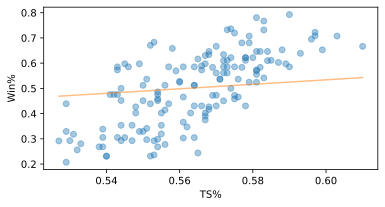

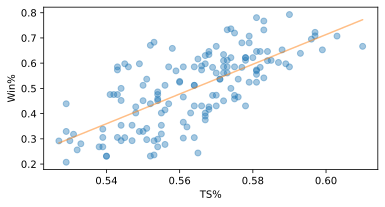

In [ ]:
#Interesting observation (huge difference in R^2 when there is no constant)
## This uncovers the difference between centered vs uncentered R^2.
## We didn't learn about this in class, but we can see that this uncentered R^2 is likely deceiving (residuals are not normal)
## Point this out in our paper, but not really make any conclusions

#Linear regression with 1 features (with no constant)
data = df_filtered[['TS%']]
X = data.to_numpy() # convert to numpy array
y = df_filtered[["Win%"]].to_numpy()
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())

#Plot the data
fig,ax = plt.subplots(figsize=(6,3))
ax.plot(X,y,"o",alpha=0.4) #
#Graph the line of best fit
a_fit = results.params
ax.plot(X,X*a_fit,"-",alpha=0.5)
ax.set_xlabel("TS%")
ax.set_ylabel("Win%")


#Graph residuals (clearly fails the normality criterion)
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Win prediction (w/out constant)")
ax.set_ylabel("Residual")

#Linear regression with same 1 features (with constant)
data = df_filtered[['TS%']]
x = data.to_numpy() # convert to numpy array
X = sm.add_constant(x) # add a column of all 1s
y = df_filtered[["Win%"]].to_numpy()
model = sm.OLS(y,X) #run OLS
results = model.fit()
print(results.summary())


#Plot the data
fig,ax = plt.subplots(figsize=(6,3))
ax.plot(x,y,"o",alpha=0.4) #
#Graph the line of best fit
b_fit,a_fit = results.params
ax.plot(x,x*a_fit + b_fit,"-",alpha=0.5)
ax.set_xlabel("TS%")
ax.set_ylabel("Win%")

#Graph residuals
r = results.resid
y_mean_pred = y - r
fig,ax = plt.subplots(figsize=(5,2))
ax.plot(y_mean_pred,r,"o", alpha = 0.25)  # Plot the residuals
ax.plot(y_mean_pred,np.zeros(len(y)),"-") # Plot the reference line of 0
ax.set_xlabel("Win prediction (w/ constant)")
ax.set_ylabel("Residual")